In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
from os.path import join
import PIL.Image
from PIL import ImageOps

import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers 
from tensorflow.keras import Model 
from tensorflow.keras.preprocessing.image import ImageDataGenerator

import warnings
warnings.filterwarnings('ignore')

# IMG_SIZE is determined by EfficientNet model choice
IMG_SIZE = 299
BATCH_SIZE = 64
EPOCHS = 30
FINE_TUNING_EPOCHS = 15
FINE_BATCH_SIZE = 12
MODEL_SAVE_PATH = './Model/saved_model'
MODEL_FILEPATH = './Model'
FINE_MODEL_FILEPATH = './Tuned/saved_model'
TF_MODEL_NAME = './dog_breed_classifier'

In [2]:
# Setup Training and Testing sets

# specify the directories
train_dir = './Data/dog-breed-identification/train'
test_dir = './Data/dog-breed-identification/test'

# get the image paths
train_img_fpaths = [join(train_dir, f) for f in os.listdir(train_dir)]
test_img_fpaths = [join(test_dir, f) for f in os.listdir(test_dir)]

# get the numberof unique training and testing samples in the training and testing directories
train_size = len(train_img_fpaths)
print('Number of training samples: ', train_size)
test_size = len(test_img_fpaths)
print('Number of testing samples: ', test_size)
print()

def append_ext(fn):
    return fn+".jpg"

# create a pandas dataframe on the training labels
df_train = pd.read_csv('./Data/dog-breed-identification/labels.csv')
df_train.rename(columns = {"breed": "label"}, inplace = True)

# create a pandas dataframe on the testing labels
df_test = pd.read_csv("./Data/dog-breed-identification/sample_submission.csv",dtype=str)
df_test.rename(columns = {"breed": "label"}, inplace = True)
df_test = df_test[df_test.columns[:list(df_test.columns).index('id')+1]]

# add jpg to file names
df_train["id"]=df_train["id"].apply(append_ext)
df_test["id"]=df_test["id"].apply(append_ext)

# print data frames
print("Training paths")
print(df_train.head())
print("Testing paths")
print(df_test.head())
print("")

print("Number of unique breeds in training data: ", len(df_train.label.unique()))

Number of training samples:  10222
Number of testing samples:  10357

Training paths
                                     id             label
0  000bec180eb18c7604dcecc8fe0dba07.jpg       boston_bull
1  001513dfcb2ffafc82cccf4d8bbaba97.jpg             dingo
2  001cdf01b096e06d78e9e5112d419397.jpg          pekinese
3  00214f311d5d2247d5dfe4fe24b2303d.jpg          bluetick
4  0021f9ceb3235effd7fcde7f7538ed62.jpg  golden_retriever
Testing paths
                                     id
0  000621fb3cbb32d8935728e48679680e.jpg
1  00102ee9d8eb90812350685311fe5890.jpg
2  0012a730dfa437f5f3613fb75efcd4ce.jpg
3  001510bc8570bbeee98c8d80c8a95ec1.jpg
4  001a5f3114548acdefa3d4da05474c2e.jpg

Number of unique breeds in training data:  120


In [3]:
# Show samples from image generator

# A helper function used to show images from a generater
def show_image_samples(gen, show_labels=True):
    if show_labels == True:
        t_dict=gen.class_indices
        classes=list(t_dict.keys())    
        images,labels=next(gen) # get a sample batch from the generator 
    else:
        images=next(gen)
    plt.figure(figsize=(20, 20))
    for i in range(25):
        plt.subplot(5, 5, i + 1)
        image=images[i]
        plt.imshow(image)
        if show_labels == True:
            index=np.argmax(labels[i])
            class_name=classes[index]
            plt.title(class_name, color='blue', fontsize=12)
        plt.axis('off')
    plt.show()


Found 8178 validated image filenames belonging to 120 classes.
Number of classes 120
Training samples


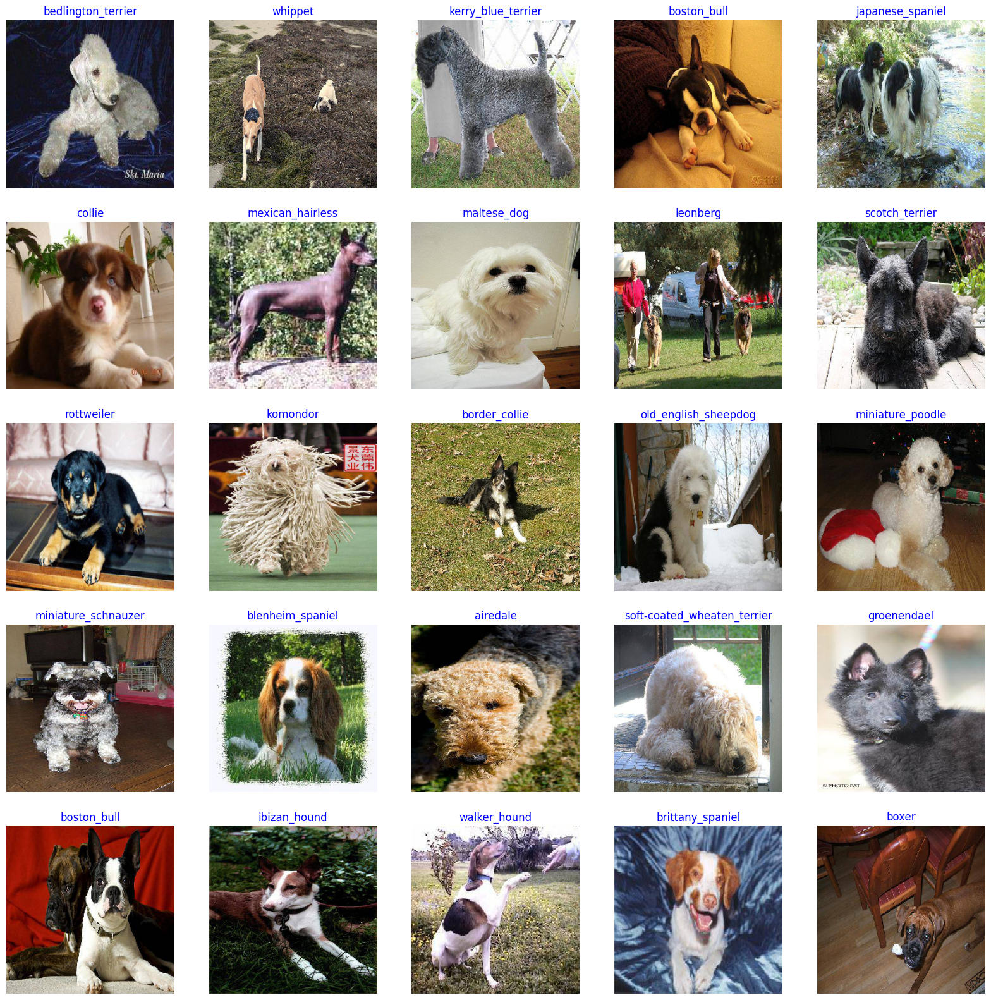

In [4]:
# Data Generator

# create the tensorflow image generator for train and validation sets
train_data_gen = ImageDataGenerator(
        rescale = 1./255, 
        fill_mode='nearest', 
        validation_split = 0.2)

# Training Generator
train_generator = train_data_gen.flow_from_dataframe(
    df_train, 
    directory = train_dir, 
    x_col = 'id', 
    y_col = 'label', 
    subset = 'training',
    class_mode = 'categorical', 
    target_size = (IMG_SIZE, IMG_SIZE),
    batch_size = BATCH_SIZE, 
    shuffle = True, 
    seed = 123)

num_classes = len(list(train_generator.class_indices.keys()))
print("Number of classes", num_classes)

print("Training samples")
show_image_samples(train_generator)

Found 2044 validated image filenames belonging to 120 classes.
Validation samples


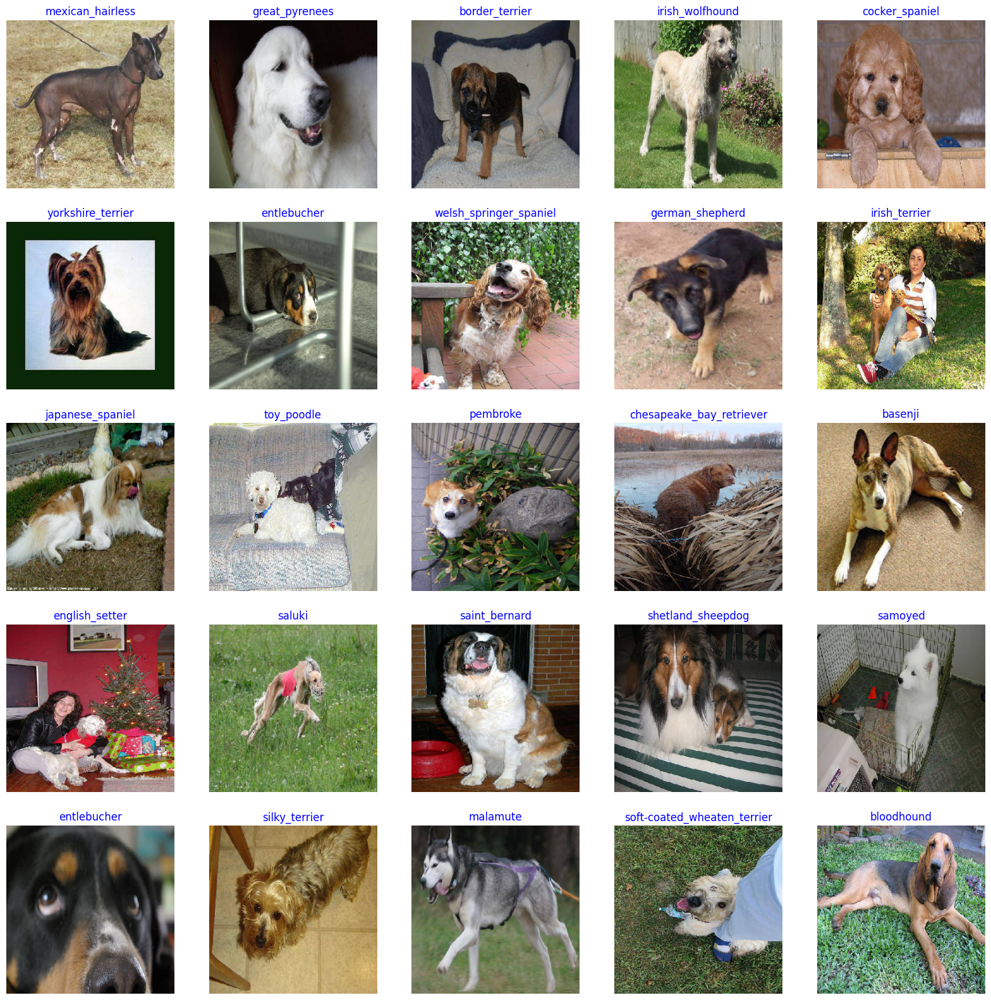

In [5]:
# Validation Generator
validation_generator = train_data_gen.flow_from_dataframe(
    dataframe=df_train, 
    directory = train_dir, 
    x_col = 'id', 
    y_col = 'label',
    subset = 'validation', 
    class_mode = 'categorical', 
    target_size = (IMG_SIZE, IMG_SIZE), 
    batch_size = BATCH_SIZE, 
    shuffle = True, 
    seed = 123)

print("Validation samples")
show_image_samples(validation_generator)

Found 10357 validated image filenames.
Testing samples


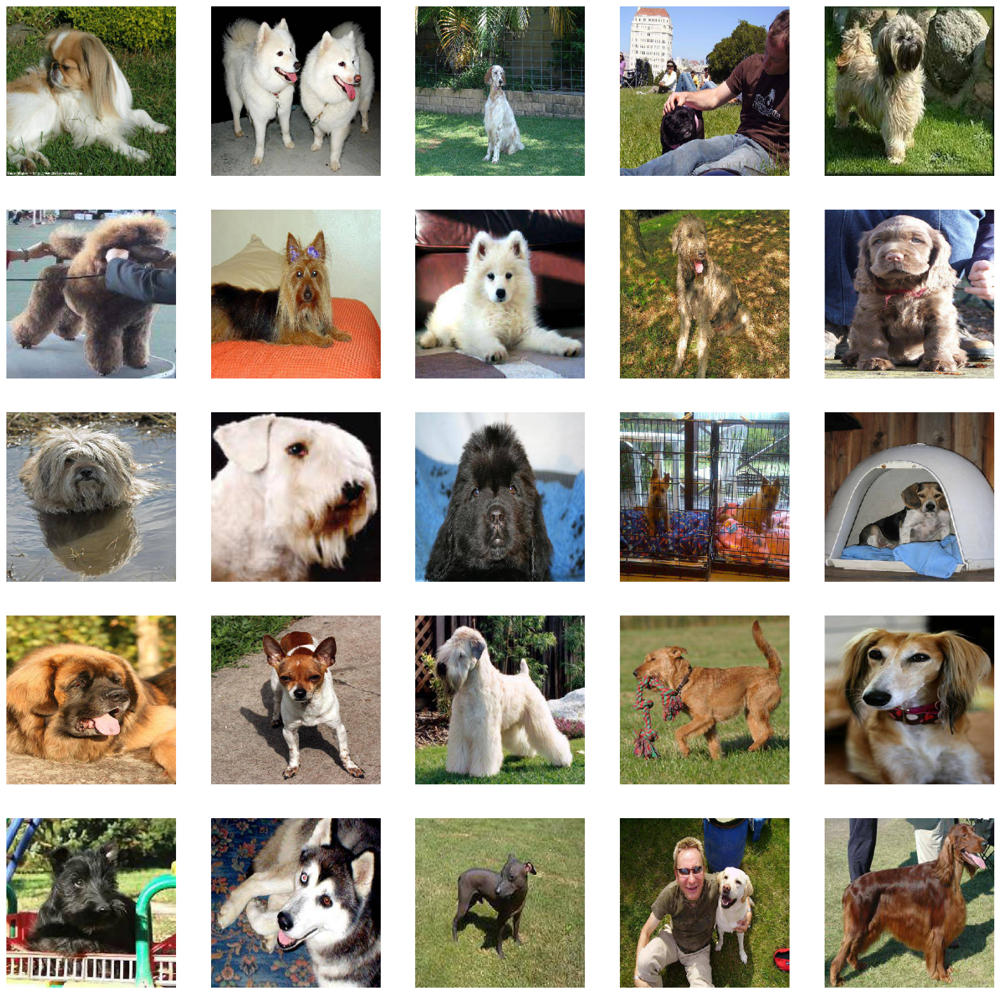

In [6]:
# Testing Generator
test_datagen = ImageDataGenerator(rescale = 1./255)
test_generator = test_datagen.flow_from_dataframe(
    dataframe=df_test,
    directory=test_dir,
    x_col="id",
    y_col=None,
    target_size=(IMG_SIZE, IMG_SIZE),
    batch_size=BATCH_SIZE,
    seed=42,
    shuffle=False,
    class_mode=None,)

print("Testing samples")
show_image_samples(test_generator, show_labels=False)

In [7]:
# Image Preprocessing & Augmentation
from tensorflow.keras.models import Sequential
from tensorflow.keras import layers

img_augmentation = Sequential(
    [
        layers.RandomRotation(factor=0.15),
        layers.RandomTranslation(height_factor=0.1, width_factor=0.1),
        layers.RandomFlip(),
        layers.RandomContrast(factor=0.1),
    ],
    name="img_augmentation",
)

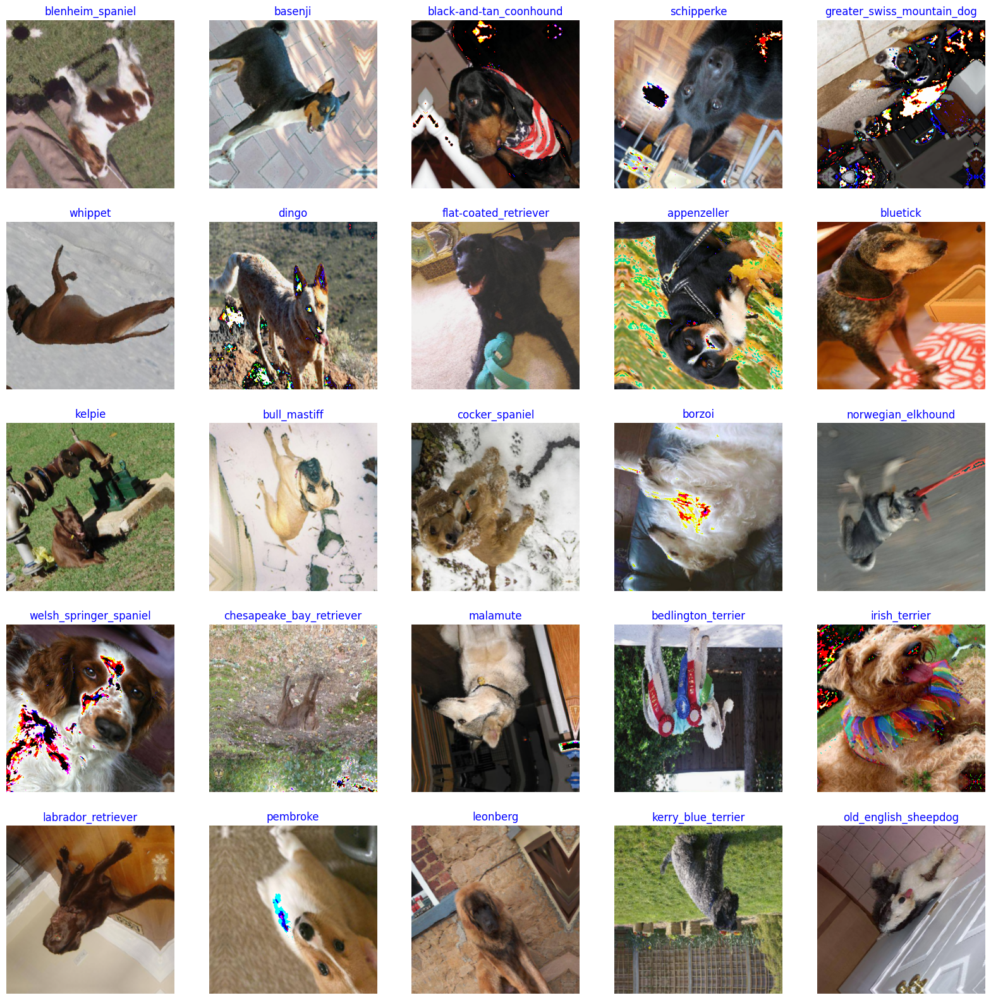

In [8]:
# Test the Augmentation function

def show_augmented_samples(gen):
    t_dict=gen.class_indices
    classes=list(t_dict.keys())    
    images,labels=next(gen) # get a sample batch from the generator 
    plt.figure(figsize=(20, 20))
    for i in range(25):
        plt.subplot(5, 5, i + 1)
        image=images[i]
        aug_img = tf.squeeze(img_augmentation(tf.expand_dims(image, axis=0)), 0) # apply augmentation
        aug_img = np.uint8(aug_img*255) # scale between 0 - 255 and convert to int
        plt.imshow(aug_img)
        index=np.argmax(labels[i])
        class_name=classes[index]
        plt.title(class_name, color='blue', fontsize=12)
        plt.axis('off')
    plt.show()
    
show_augmented_samples(train_generator)

In [9]:
# Transfer Learning Model Details

base_model = keras.applications.Xception(
    weights="imagenet",
    include_top=False, 
    input_shape=(IMG_SIZE, IMG_SIZE, 3)
)

# Freeze the pretrained weights
base_model.trainable = False

# Rebuild layers on top
inputs = keras.Input(shape=(IMG_SIZE, IMG_SIZE, 3))
x = img_augmentation(inputs)  # Apply random data augmentation

# Pre-trained Xception weights requires that input be scaled
# from (0, 255) to a range of (-1., +1.), the rescaling layer
# outputs: `(inputs * scale) + offset`
scale_layer = keras.layers.Rescaling(scale=1 / 127.5, offset=-1)
x = scale_layer(x)

# The base model contains batchnorm layers. We want to keep them in inference mode
# when we unfreeze the base model for fine-tuning, so we make sure that the
# base_model is running in inference mode here.
x = base_model(inputs, training=False)
x = keras.layers.GlobalAveragePooling2D()(x)
x = keras.layers.Dropout(0.2)(x)  # Regularize with dropout
outputs = layers.Dense(
    num_classes, 
    activation="softmax", 
    name="output")(x)

model = keras.Model(inputs, outputs)

model.summary()


Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 299, 299, 3)]     0         
                                                                 
 xception (Functional)       (None, 10, 10, 2048)      20861480  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 output (Dense)              (None, 120)               245880    
                                                                 
Total params: 21,107,360
Trainable params: 245,880
Non-trainable params: 20,861,480
___________________________________________

In [10]:
# Setup a model checkpoint and early stopping condition

callbacks_list = [
    tf.keras.callbacks.ModelCheckpoint(
        filepath = MODEL_FILEPATH, 
        monitor = 'val_loss', 
        save_best_only = True, 
        verbose = 1),
    tf.keras.callbacks.EarlyStopping(
        monitor = 'val_loss', 
        patience = 10, 
        verbose = 1)
]

# Compile the model
model.compile(
    optimizer='rmsprop',
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)


In [11]:
# train the model

history = model.fit(train_generator,
                    steps_per_epoch = train_generator.samples // BATCH_SIZE,
                    epochs = EPOCHS,
                    callbacks = callbacks_list,
                    validation_data = validation_generator,
                    verbose = 1,
                    validation_steps = validation_generator.samples // BATCH_SIZE)

Epoch 1/30
127/127 [==============================] - ETA: 0s - loss: 1.5338 - accuracy: 0.7556
Epoch 00001: val_loss improved from inf to 0.50200, saving model to ./Model/saved_model
INFO:tensorflow:Assets written to: ./Model/saved_model/assets
127/127 [==============================] - 100s 748ms/step - loss: 1.5338 - accuracy: 0.7556 - val_loss: 0.5020 - val_accuracy: 0.8810
Epoch 2/30
127/127 [==============================] - ETA: 0s - loss: 0.3726 - accuracy: 0.8986
Epoch 00002: val_loss improved from 0.50200 to 0.37943, saving model to ./Model/saved_model
INFO:tensorflow:Assets written to: ./Model/saved_model/assets
127/127 [==============================] - 94s 737ms/step - loss: 0.3726 - accuracy: 0.8986 - val_loss: 0.3794 - val_accuracy: 0.8831
Epoch 3/30
127/127 [==============================] - ETA: 0s - loss: 0.2838 - accuracy: 0.9139
Epoch 00003: val_loss improved from 0.37943 to 0.33863, saving model to ./Model/saved_model
INFO:tensorflow:Assets written to: ./Model/save

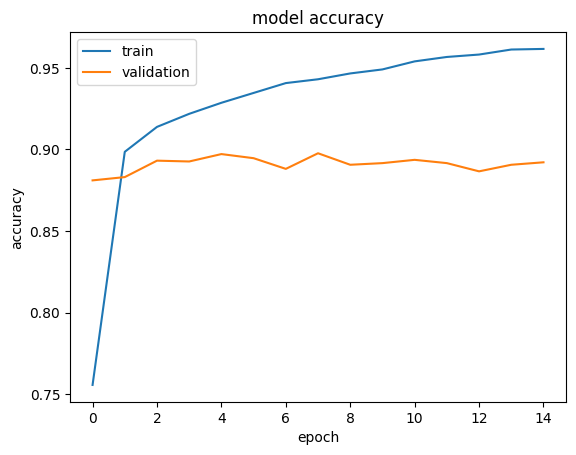

In [12]:
# A helper function used to plot our training data
def plot_hist(hist):
    plt.plot(hist.history["accuracy"])
    plt.plot(hist.history["val_accuracy"])
    plt.title("model accuracy")
    plt.ylabel("accuracy")
    plt.xlabel("epoch")
    plt.legend(["train", "validation"], loc="upper left")
    plt.show()
    
plot_hist(history)

In [13]:
# Training Generator
fine_tune_train_generator = train_data_gen.flow_from_dataframe(
    df_train, 
    directory = train_dir, 
    x_col = 'id', 
    y_col = 'label', 
    subset = 'training',
    class_mode = 'categorical', 
    target_size = (IMG_SIZE, IMG_SIZE),
    batch_size = FINE_BATCH_SIZE, 
    shuffle = True, 
    seed = 123)

# Validation Generator
fine_tune_validation_generator = train_data_gen.flow_from_dataframe(
    dataframe=df_train, 
    directory = train_dir, 
    x_col = 'id', 
    y_col = 'label',
    subset = 'validation', 
    class_mode = 'categorical', 
    target_size = (IMG_SIZE, IMG_SIZE), 
    batch_size = FINE_BATCH_SIZE, 
    shuffle = True, 
    seed = 123)

Found 8178 validated image filenames belonging to 120 classes.
Found 2044 validated image filenames belonging to 120 classes.


In [35]:
# Load Model
model = tf.keras.models.load_model(MODEL_SAVE_PATH)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 299, 299, 3)]     0         
                                                                 
 xception (Functional)       (None, 10, 10, 2048)      20861480  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 output (Dense)              (None, 120)               245880    
                                                                 
Total params: 21,107,360
Trainable params: 245,880
Non-trainable params: 20,861,480
___________________________________________

Epoch 1/15
681/681 [==============================] - ETA: 0s - loss: 0.1909 - accuracy: 0.9396
Epoch 00001: val_loss improved from inf to 0.33017, saving model to ./Tuned/saved_model
INFO:tensorflow:Assets written to: ./Tuned/saved_model/assets
681/681 [==============================] - 352s 510ms/step - loss: 0.1909 - accuracy: 0.9396 - val_loss: 0.3302 - val_accuracy: 0.8941
Epoch 2/15
681/681 [==============================] - ETA: 0s - loss: 0.1480 - accuracy: 0.9541
Epoch 00002: val_loss did not improve from 0.33017
681/681 [==============================] - 325s 477ms/step - loss: 0.1480 - accuracy: 0.9541 - val_loss: 0.3377 - val_accuracy: 0.8912
Epoch 3/15
681/681 [==============================] - ETA: 0s - loss: 0.1187 - accuracy: 0.9655
Epoch 00003: val_loss did not improve from 0.33017
681/681 [==============================] - 325s 476ms/step - loss: 0.1187 - accuracy: 0.9655 - val_loss: 0.3434 - val_accuracy: 0.8975
Epoch 4/15
681/681 [==============================] - E

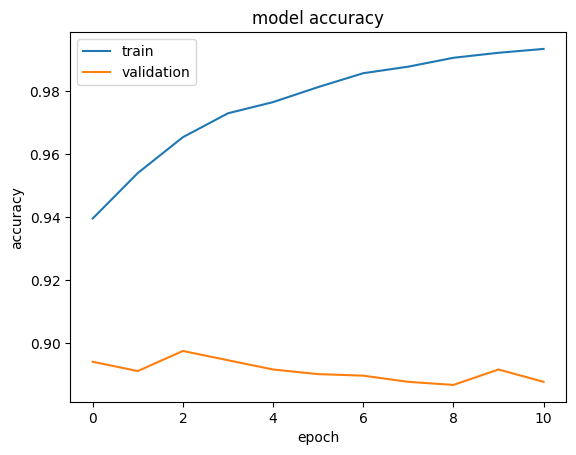

In [36]:
# Fine Tune the Model

# Unfreeze the base_model. Note that it keeps running in inference mode
# since we passed `training=False` when calling it. This means that
# the batchnorm layers will not update their batch statistics.
# This prevents the batchnorm layers from undoing all the training
# we've done so far.
# base_model.trainable = True

fine_tune_callbacks_list = [
    tf.keras.callbacks.ModelCheckpoint(
        filepath = FINE_MODEL_FILEPATH, 
        monitor = 'val_loss', 
        save_best_only = True, 
        verbose = 1),
    tf.keras.callbacks.EarlyStopping(
        monitor = 'val_loss', 
        patience = 10, 
        verbose = 1)
]

# Setup model for fine tuning
def setup_fine_tune_model(model, trainable):
    # Freeze the un-trainable layers of the model base
    for layer in model.layers[:(len(model.layers) - trainable)]:
        layer.trainable = False

    for layer in model.layers[(len(model.layers) - trainable):]:
        layer.trainable = True

    model.compile(
        loss='categorical_crossentropy',
        # Slower training rate for fine-tuning
        optimizer=tf.keras.optimizers.SGD(lr=1e-4, momentum=0.9),
        metrics=['accuracy']
    )
    
    return model
    
print(model)

fine_tune_model = setup_fine_tune_model(model, 19)

print(fine_tune_model)

history_tuned = model.fit(
    fine_tune_train_generator,
    steps_per_epoch = fine_tune_train_generator.samples // FINE_BATCH_SIZE,
    epochs = FINE_TUNING_EPOCHS,
    callbacks = fine_tune_callbacks_list,
    validation_data = fine_tune_validation_generator,
    verbose = 1,
    validation_steps = fine_tune_validation_generator.samples // FINE_BATCH_SIZE
)

plot_hist(history_tuned)

In [50]:
# Load Model
model = tf.keras.models.load_model(MODEL_SAVE_PATH)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 299, 299, 3)]     0         
                                                                 
 xception (Functional)       (None, 10, 10, 2048)      20861480  
                                                                 
 global_average_pooling2d (G  (None, 2048)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dropout (Dropout)           (None, 2048)              0         
                                                                 
 output (Dense)              (None, 120)               245880    
                                                                 
Total params: 21,107,360
Trainable params: 245,880
Non-trainable params: 20,861,480
___________________________________________

In [51]:
# Prepare Image for Test

import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing.image import load_img
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.applications.imagenet_utils import decode_predictions
# Predict the image
from tensorflow.keras.applications.xception import preprocess_input

def prepare_image(filename):
    # load an image in PIL format
    original = load_img(filename, target_size=(IMG_SIZE, IMG_SIZE))

    # convert the PIL image to a numpy array
    # IN PIL - image is in (width, height, channel)
    # In Numpy - image is in (height, width, channel)
    numpy_image = img_to_array(original)

    # Convert the image / images into batch format
    # expand_dims will add an extra dimension to the data at a particular axis
    # We want the input matrix to the network to be of the form (batchsize, height, width, channels)
    # Thus we add the extra dimension to the axis 0.
    image_batch = np.expand_dims(numpy_image, axis=0)
    
    # prepare the image for the xception model
    processed_image = tf.keras.applications.xception.preprocess_input(image_batch.copy())
    
    return numpy_image, processed_image

1/1 [==============================] - 1s 588ms/step


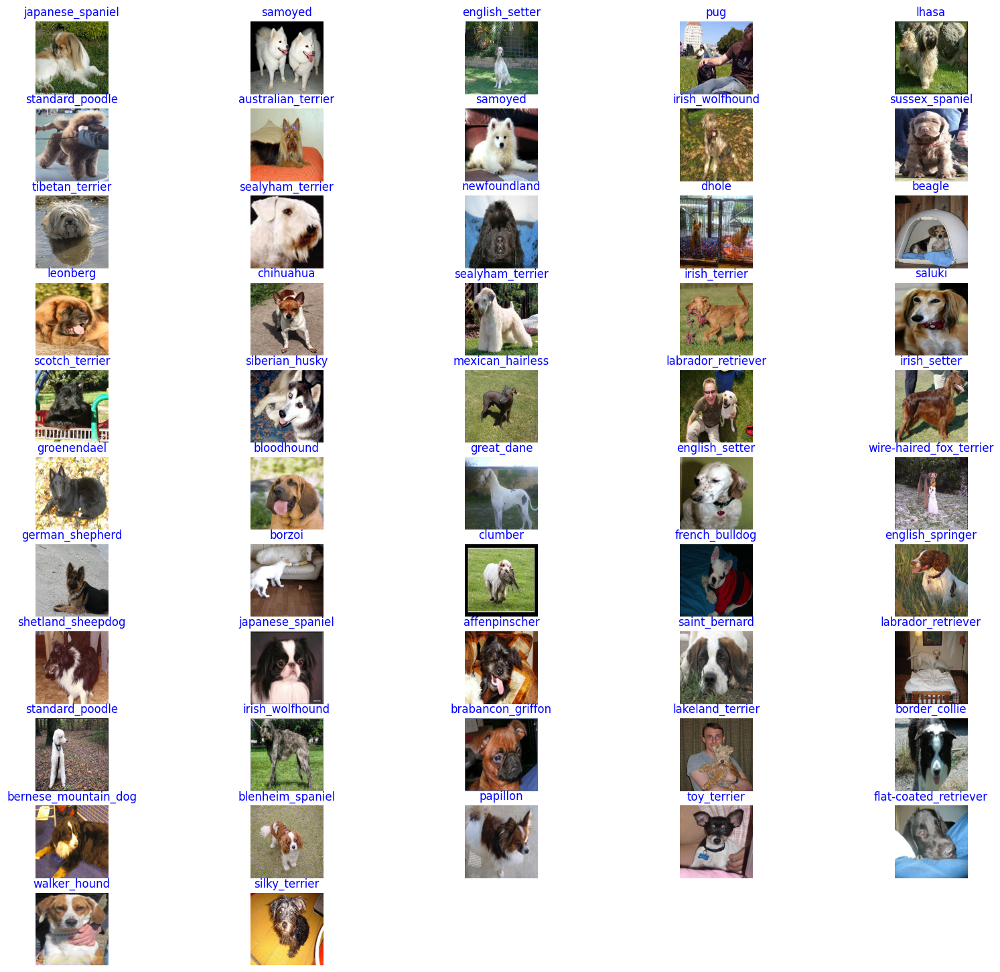

In [60]:
# Test samples from test image generator

def generate_predictions():
    test_generator.reset()

    # Get the file names for one batch of the validator
    filenames = test_generator.filenames[:BATCH_SIZE]

    # Get the predictions from the model
    pred = model.predict_generator(
        test_generator,
        steps=1,
        verbose=1
    )

    # Get the prediction lables
    predicted_class_indices = np.argmax(pred,axis=1)
    
    labels = (train_generator.class_indices)
    labels = dict((v,k) for k,v in labels.items())
    prediction_lables = [labels[k] for k in predicted_class_indices]

    return [filenames, prediction_lables]

# A helper function used to plot predictions labels with photo's
def plot_predictions(filenames, predictions):
    plt.figure(figsize=(20, 20))
    for filename, prediction, index in zip(filenames, predictions, range(len(predictions))):
        if index < (len(predictions) - len(predictions) / 5):
            # get the image as a numpy array
            numpy_image, _ = prepare_image(test_dir+'/'+filename)

            plt.subplot(len(predictions)/5, 5, index + 1)
            plt.imshow(np.uint8(numpy_image))
            plt.title(prediction, color='blue', fontsize=12)
#             plt.imshow(np.uint8(numpy_image))
#             plt.show()
            plt.axis('off')
    plt.show()
        
        
# A helper function used to show images from a generater
def show_image_samples(gen, show_labels=True):

    t_dict=gen.class_indices
    classes=list(t_dict.keys())    
    images,labels=next(gen) # get a sample batch from the generator 

    plt.figure(figsize=(20, 20))
    for i in range(25):
        plt.subplot(5, 5, i + 1)
        image=images[i]

        plt.imshow(image)
        index=np.argmax(labels[i])
        class_name=classes[index]
        plt.title(class_name, color='blue', fontsize=10)
        plt.axis('off')
    plt.show()
    
prediction_arrays = generate_predictions()
filenames = prediction_arrays[0]
predictions = prediction_arrays[1]
plot_predictions(filenames, predictions)
        

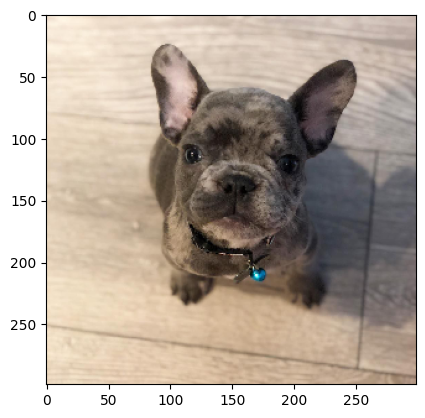

french_bulldog


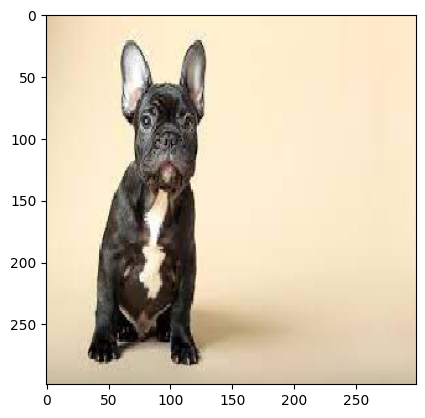

french_bulldog


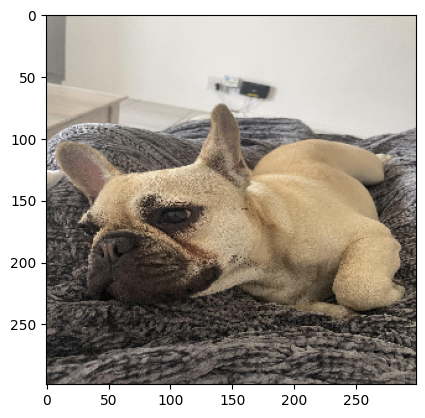

french_bulldog


In [66]:
# Test the model with manually downloaded images

def manual_test(filename):
    numpy_image, processed_image = prepare_image('./Data/dog-breed-identification/manual/'+filename)

    # Decode prediction
    # get the predicted probabilities for each class
    predictions = model.predict(processed_image)
    # get the predicted class index
    predicted_class_indices = np.argmax(predictions,axis=1)

    # get the class lables
    labels = (train_generator.class_indices)
    labels = dict((v,k) for k,v in labels.items())
    prediction_lables = [labels[k] for k in predicted_class_indices]

    # get the predicted class label
    prediciton = labels[predicted_class_indices[0]]

    # print the picture with prediction
    plt.imshow(np.uint8(numpy_image))
    plt.show()
    print(prediciton)
    
filename = '1.jpg'
filename_1 = '2.jpg'
filename_2 = '3.jpg'
manual_test(filename)
manual_test(filename_1)
manual_test(filename_2)